# Facial Landmarks detection with dlib, OpenCV, and Python


This implemetaion is based on the work of Kazemi and Sullivan et. al. ( One Millisecond Face Alignment with an Ensemble of Regression Trees -2014).

## What are facial landmarks?

Detecting Facial Landmarks is a subset of _shape prediction problem_. Given an input image (and usually an ROI that specifies object of interest), a shape predictor attempts to localize the key points of interest along the shape.

In the context of Facial Landmarks, or goal is to detect important facial structures on the face using shape prediction methods.
 - **Step #1:** Localize the face in the image
 - **Step #2:** Detect the key facial structures on the face ROI
 
For completion of _Step#1_ we need an algo that gives us a bounding box localizing the face in the image. We can either use HAAR Cascades, HOG + Linear SVM object detector or even a deep learnging based face detector.


Given the face region we can move on to _Step #2_ detecting key structures in the face region.

There are a variety of facial landmark detectors, but all methods essentially try to localize and label the following facial regions:

- Mouth
- Right eyebrow
- Left eyebrow
- Right eye
- Left eye
- Nose
- Jaw

The paper by _Kazemi et. al_ does this using:
1. A training set of labeled facial landmarks on an image. These images are manually labeled, specifying specific (x, y)-coordinates of regions surrounding each facial structure.

2. Priors, of more specifically, the probability on distance between pairs of input pixels.


Given this training data, an ensemble of regression trees are trained to estimate the facial landmark positions directly from the pixel intensities themselves (i.e., no “feature extraction” is taking place).

The end result is a facial landmark detector that can be used to __detect facial landmarks in real-time with high quality predictions__.


## Dlib's Facial Landmark Detector
As the name suggests, it allows you to perform face pose estimation very quickly. In particular, this means that if you give it an image of someone's face it will add this kind of annotation:

<img src ='http://1.bp.blogspot.com/-FtyIjfFokzQ/U__h1sAoEEI/AAAAAAAAAR0/URuVhX9cR-E/s1600/landmarked_face2.png'>

The pre-trained facial landmark detector inside the dlib library is used to estimate the location of ___68 (x, y)-coordinates___ that map to facial structures on the face.

The indexes of the 68 coordinates can be visualized on the image below:

<img src='https://www.pyimagesearch.com/wp-content/uploads/2017/04/facial_landmarks_68markup.jpg'>

These annotations are part of the 68 point iBUG 300-W dataset which the dlib facial landmark predictor was trained on.

It’s important to note that other flavors of facial landmark detectors exist, including the 194 point model that can be trained on the HELEN dataset.

Regardless of which dataset is used, the same dlib framework can be leveraged to train a shape predictor on the input training data — this is useful if you would like to train facial landmark detectors or custom shape predictors of your own.


## Let's get on to the code


In [1]:
from imutils import face_utils
import numpy as np
import imutils
import dlib
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
dlib.__version__

'19.4.0'

In [3]:
# define paths

# This is the path to the facial landmark perdictor 
path_shape_predictor = "shape_predictor_68_face_landmarks.dat"

# path to input image
path_image = 'images\\zukker.jpg'

In [4]:
# initialize dlib's face detector(HOG-based) and then create 
# the facial landmark predictor
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor(path_shape_predictor)


Before we can actually detect facial landmarks, we first need to detect the face in the image. Let's visualize everything along the way.

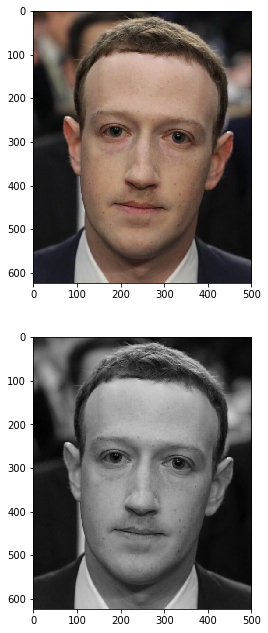

In [5]:
fig, ax = plt.subplots(2, 1, figsize=(22,11))

# load the input image, resize it, and convert it to grayscale
image = cv2.imread(path_image)

# resize the image
image = imutils.resize(image, width=500)
ax[0].imshow(image[...,::-1])

# gray image
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
ax[1].imshow(gray, cmap='gray')

plt.show()

Now, we can go on to detect faces in our image

In [6]:
# detect faces in the grayscale image
rects = detector(gray, 1)

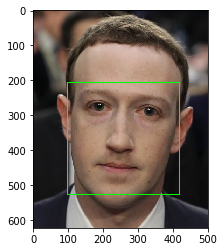

In [7]:
# get the coordinates from the 'dlib.rectangle' object. This helper function
# converts dlib.rectangle to bounding box coordinates
(x, y, w, h) = face_utils.rect_to_bb(rect = rects[0]) # I know there is atleast only one face in the image above, 
                                          # so a hardcoded to visualize    
    
im = cv2.rectangle(image.copy(), pt1=(x,y), pt2=(x+w, y+h),color=(0,255,0), thickness=2)
plt.imshow(im[...,::-1])
plt.show()

Lets put out localized face thorough our predictor and see in what order it draws the landmarks

In [8]:
shape = predictor(gray, rects[0])
shape = face_utils.shape_to_np(shape)
print(shape.shape)

(68, 2)


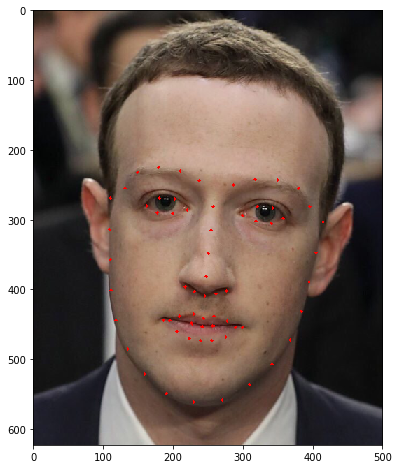

In [9]:
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"
fig = plt.figure(figsize=(8,8))

# loop over the (x, y)-coordinates for the facial landmarks
# and draw them on the image
img = image.copy()

imgs = []
for x, y in shape:
    cv2.circle(img, (x,y), radius=2, color=(0,0,255), thickness=-1)
    i = plt.imshow(img[...,::-1], animated=True)
    imgs.append([i])
    
ani = animation.ArtistAnimation(fig, imgs, interval=50, blit=True,
                                repeat_delay=1000)

from matplotlib.animation import FFMpegWriter
writer = FFMpegWriter(fps=15, metadata=dict(artist='Me'), bitrate=1800)
ani.save("zukker.mp4", writer=writer)

from IPython.display import HTML
HTML(ani.to_jshtml())


Given an array of face detections we can now loop over them and draw their landmarks.

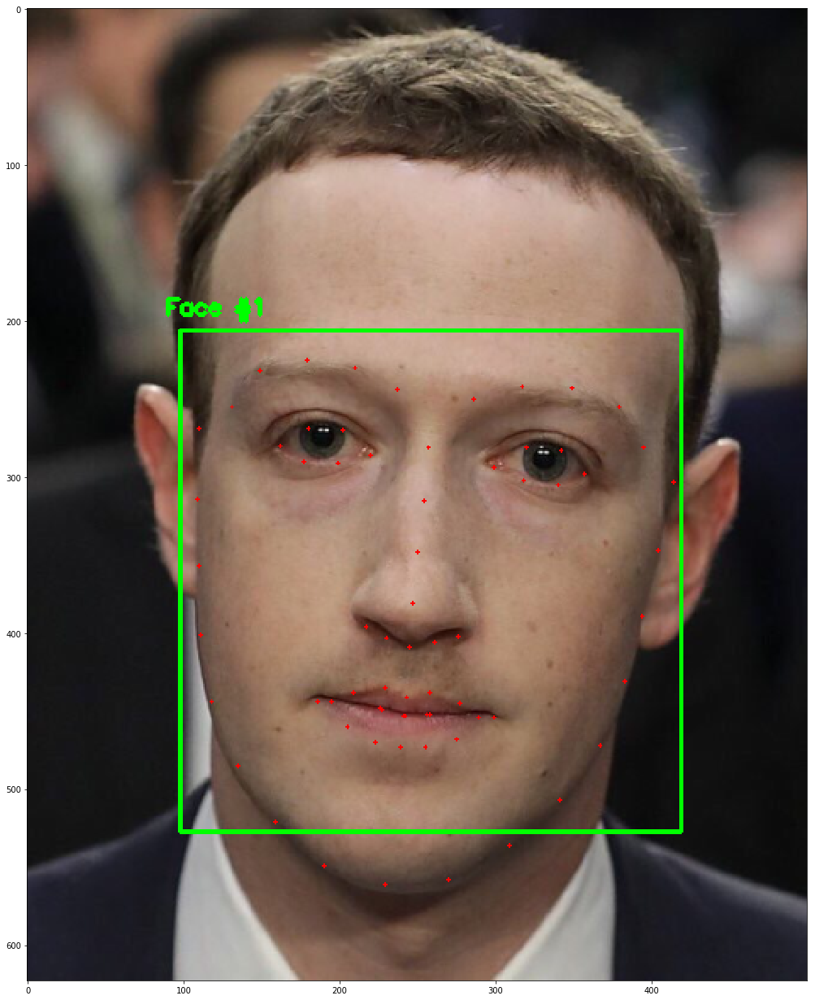

In [10]:
# loop over the face detections
image_copy = image.copy()
for i, rect in enumerate(rects):
    # determine the facial landmarks of the face region, then
    # convert the facial landmark (x, y)-coordinates to a NumPy
    # array
    shape = predictor(gray, rect) # returns dlib.shape object containing
                                  # our 68 x,y-coordinates. We need to 
                                  # convert this to a NumPy array
    
    # shape_to_np is helper function to convert dlib.shape->NP array
    shape = face_utils.shape_to_np(shape) # returns np_array of shape(68,2)
    
    # convert dlib's rectangle to a OpenCv-style boundig box
    (x, y, w, h) = face_utils.rect_to_bb(rect)
    cv2.rectangle(image_copy, (x,y), (x+w, y+h), (0 ,255, 0), 2)
    
    # show the face number
    cv2.putText(image_copy, "Face #{}".format(i+1), (x-10, y-10), 
               cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    
    # loop over the (x, y)-coordinates for the facial landmarks
    # and draw them on the image
    for x, y in shape:
        cv2.circle(image_copy, (x,y), 1, (0,0,255), -1)

fig = plt.figure(figsize=(22,22))
plt.imshow(image_copy[...,::-1])
plt.show()

 ## Let's try using deep learning based detector

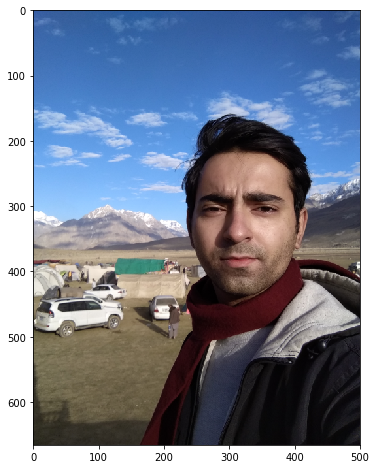

In [11]:
# model_architecture_path is the ".prototxt" file with defines the model architecture(i.e layers) 
model_architecture_path = "..\\DNN_MODELS\\opencv_face_detector.prototxt"
# caffe_model_path is the ".caffemodel" file which contains the trained weights for the layers
caffe_model_path = '..\\DNN_MODELS\\opencv_face_detector.caffemodel'

# define confidence threhold
thresh = 0.5

# image path
path_image = '..\\Face_Detector\\myimg4.jpg'

img = cv2.imread(path_image)
img = imutils.resize(img, width=500)

fig = plt.figure(figsize=(11,8))
plt.imshow(img[...,::-1])
plt.show()


In [12]:
(h,w) = img.shape[:2] # store image dimensions

# load up the model
net = cv2.dnn.readNetFromCaffe(model_architecture_path, caffe_model_path)
# This is the path to the facial landmark perdictor 
path_shape_predictor = "shape_predictor_68_face_landmarks.dat"
predictor = dlib.shape_predictor(path_shape_predictor)

# get blob from image  and resize image for input into model
blob = cv2.dnn.blobFromImage(cv2.resize(img, (300,300)), 1.0, size=(300,300), mean=(104.0, 177.0, 123.0))

# pass blobs through the net
net.setInput(blob)
detections = net.forward()
print(detections.shape)

print(img.shape)

(1, 1, 144, 7)
(666, 500, 3)


In [13]:
# loop over detection
for i in range(detections.shape[2]):
    # extract confidenc of detection
    confidence = detections[0,0,i,2]
    
    # filter out weak detections
    if confidence >= thresh:
        print(confidence)    
        # compute the (x, y)-coordinates of the bounding box for the object
        box = detections[0, 0, i, 3:7] * np.array([w,h,w,h])
        (startX, startY, endX, endY) = box.astype("int")
        
        # create dlib rectangle
        rect = dlib.rectangle(int(startX), int(startY), int(endX), int(endY))
        # determine the facial landmarks of the face region, then
        # convert the facial landmark (x, y)-coordinates to a NumPy
        # array
        shape = predictor(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY), rect) # returns dlib.shape object containing
                                  # our 68 x,y-coordinates. We need to 
                                  # convert this to a NumPy array
    
        # shape_to_np is helper function to convert dlib.shape->NP array
        shape = face_utils.shape_to_np(shape) # returns np_array of shape(68,2)
        
        
        # draw bounding box of the face 
        y = startY - 10 if startY -10 > 10 else startY +10
        img= cv2.rectangle(img=img, pt1=(startX, startY), pt2=(endX, endY),
                     color=(0,0,255), thickness=2)
        
        # show the face number
        cv2.putText(img, "Face #{}".format(i+1), (startX-10, y-10), 
               cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    
        # loop over the (x, y)-coordinates for the facial landmarks
        # and draw them on the image
        for x, y in shape:
            cv2.circle(img, (x,y), 3, (0,0,255), -1)

0.999889


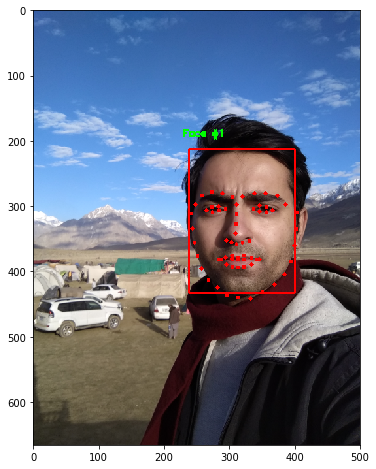

In [18]:
fig = plt.figure(figsize=(11,8))
plt.imshow(img[...,::-1])
plt.show()